<a href="https://colab.research.google.com/github/KaterynaSiniuta/ML-Hillel/blob/main/HW_3_Pandas_Visualization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Matplotlib forms basis for visualization in Python
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
# We will use the Seaborn library
import seaborn as sns

sns.set()

# Graphics in SVG format are more sharp and legible
%config InlineBackend.figure_format = 'svg'

**ДЗ 4. Pandas. Візуализація**

Зробити аналіз датасета. Побудувати не менше 10 зображень, графіків, діаграм.

По кожній картинці зробити невелике резюме.

Створити не менше 5 нових фічей вручну

Додатково -  застосувати бібліотеку для автоматичної генерації нових фічей


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
players = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Players.csv')
seasons_stats = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Seasons_Stats.csv')
player_data = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/player_data.csv')

NameError: name 'pd' is not defined

In [ ]:
# Спочатку подивимось на перший дата сет
print("Players info:")
print(players.info(), "\n")

players.head()

Players info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3922 entries, 0 to 3921
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Unnamed: 0   3922 non-null   int64  
 1   Player       3921 non-null   object 
 2   height       3921 non-null   float64
 3   weight       3921 non-null   float64
 4   collage      3573 non-null   object 
 5   born         3921 non-null   float64
 6   birth_city   3452 non-null   object 
 7   birth_state  3439 non-null   object 
dtypes: float64(3), int64(1), object(4)
memory usage: 245.3+ KB
None 



,Unnamed: 0,Player,height,weight,collage,born,birth_city,birth_state
0,0,Curly Armstrong,180.0,77.0,Indiana University,1918.0,NaN,NaN
1,1,Cliff Barker,188.0,83.0,University of Kentucky,1921.0,Yorktown,Indiana
2,2,Leo Barnhorst,193.0,86.0,University of Notre Dame,1924.0,NaN,NaN
3,3,Ed Bartels,196.0,88.0,North Carolina State University,1925.0,NaN,NaN
4,4,Ralph Beard,178.0,79.0,University of Kentucky,1927.0,Hardinsburg,Kentucky


In [ ]:
# Видалимо стовпець індексів
players = players.loc[:, ~players.columns.str.contains("^Unnamed")]

# Тепер виправимо тип даних для поля `born` та замінемо NaN на 0 щоб були значення далі цифрові
players["born"] = players["born"].fillna(0).astype("int16")
players.head()

<ipython-input-5-4c2033181c01>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  players["born"] = players["born"].fillna(0).astype("int16")


,Player,height,weight,collage,born,birth_city,birth_state
0,Curly Armstrong,180.0,77.0,Indiana University,1918,NaN,NaN
1,Cliff Barker,188.0,83.0,University of Kentucky,1921,Yorktown,Indiana
2,Leo Barnhorst,193.0,86.0,University of Notre Dame,1924,NaN,NaN
3,Ed Bartels,196.0,88.0,North Carolina State University,1925,NaN,NaN
4,Ralph Beard,178.0,79.0,University of Kentucky,1927,Hardinsburg,Kentucky


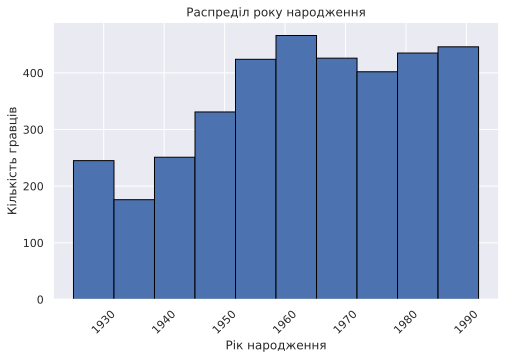

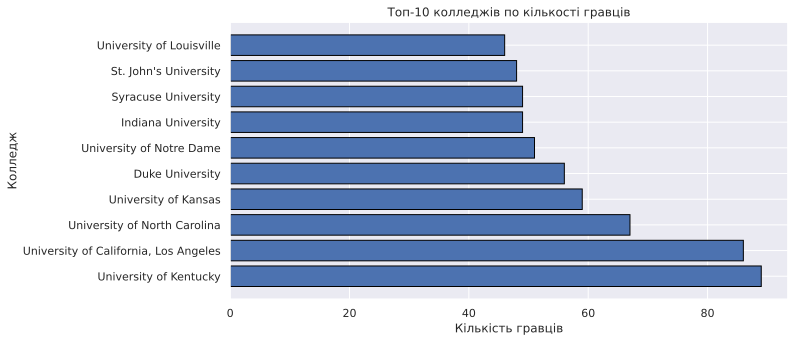

In [ ]:
players = players.dropna(subset=['born'])

# Определяем діапазон для кращої наглядності
min_year = players['born'].quantile(0.05)  # Нижняя граница (5-й процентиль)
max_year = players['born'].quantile(0.95)  # Верхняя граница (95-й процентиль)

# Гистограмма распределения года рождения игроков
plt.figure(figsize=(8, 5))
plt.hist(players['born'], bins=10, edgecolor='black', range=(min_year, max_year))
plt.xlabel('Рік народження')
plt.ylabel('Кількість гравців')
plt.title('Распреділ року народження')
plt.xticks(rotation=45)
plt.show()

# Топ-10 университетов по кількості гравців
top_colleges = players['collage'].value_counts().head(10)

# Гістограмма топ-10 университетів по кількості на універ
plt.figure(figsize=(10, 5))
plt.barh(top_colleges.index, top_colleges.values, edgecolor='black')
plt.xlabel('Кількість гравців')
plt.ylabel('Колледж')
plt.title('Топ-10 колледжів по кількості гравців')
plt.show()

Гыстограма по рокам демонструє, щоо початок даних десь у 20х роках 20 століття. Баскетбол винайшли у 1991 році, тому і даних на раніше нема, а перші змагання приходяться на 20-30 ті роки 20 століття. Скоріш за все датасет старий, тому і даних за 21 і кінець 20го нема. На піку був у 60х.

Гістограма про кількість гравців демонструє топ 10 колледжів. Можна зробити висновок, що в топ 2 університетах дуже сильна програма тренувань.

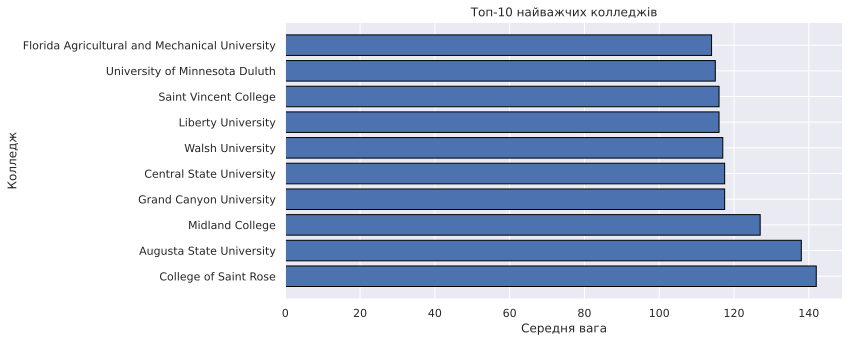

In [ ]:
top_colleges_weight = players.groupby('collage')['weight'].mean().dropna().sort_values(ascending=False).head(10)

# Гістограмма топ 10 колледжів по вазі
plt.figure(figsize=(10, 5))
plt.barh(top_colleges_weight.index, top_colleges_weight.values, edgecolor='black')
plt.xlabel('Середня вага')
plt.ylabel('Колледж')
plt.title('Топ-10 найважчих колледжів')
plt.show()

Мені здається, що в університетф Рози дуже гарні столові і смачна їжа))) ЦІкаво, що топ середньої ваги і топ по кількості баскетболістів не співпадає. Може там по 1 гравцю з універа з вагою 140 і більше ніхто й не грає бо він всіх зїв.

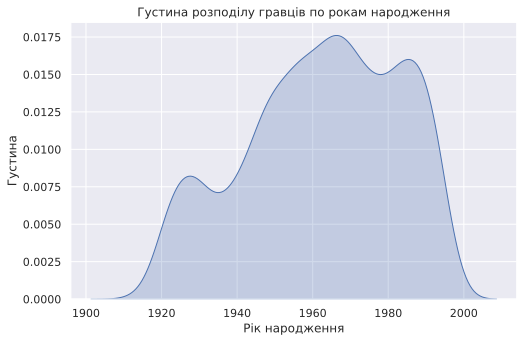

In [ ]:
# Густина розподілу року народження
plt.figure(figsize=(8, 5))
sns.kdeplot(players['born'][players['born'] > 0], fill=True)
plt.xlabel('Рік народження')
plt.ylabel('Густина')
plt.title('Густина розподілу гравців по рокам народження')
plt.show()

Можно більш наглядно побачити невеликий спад інтересу на бейсбол у 35 десь році.і у 1977 . У 1935 році баскетбол став олімпійськіим видом спорту і відтоди великий скачок. У 80х була велика конкуренція між видами спорту може тому був спад популярності.

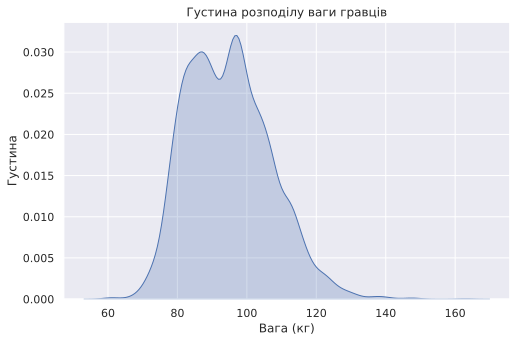

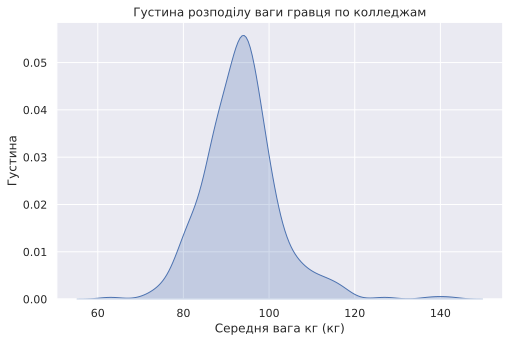

In [ ]:
# Густина розподілу ваги гравців
plt.figure(figsize=(8, 5))
sns.kdeplot(players['weight'], fill=True)
plt.xlabel('Вага (кг)')
plt.ylabel('Густина')
plt.title('Густина розподілу ваги гравців')
plt.show()

# Плотность распределения среднего веса игроков по университетам
top_colleges_weight = players.groupby('collage')['weight'].mean().dropna()
plt.figure(figsize=(8, 5))
sns.kdeplot(top_colleges_weight, fill=True)
plt.xlabel('Середня вага кг (кг)')
plt.ylabel('Густина')
plt.title('Густина розподілу ваги гравця по колледжам')
plt.show()


Розподіл ваги по колледжам сзожий на нормальним зі здвигом ліворуч, а просто кожного гравця схожий на фігуру розвороту тренда.... Це бімодальний розподіл, що може свідчити що є дві основні групи. можливо, різний гендер, або позиція гравця. легкі та швидкі - розігруючі та нападаючі та тяжкі високі - центрові та форварди

Давайте подивимося чи є викиди у вазі

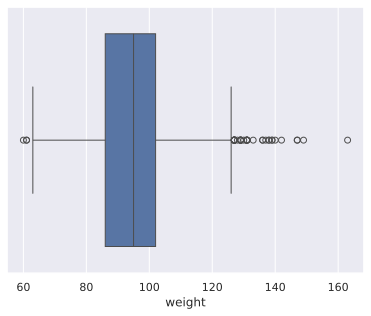

In [ ]:
sns.boxplot(x="weight", data=players);


Дуже не типовим є вага у 60 кг і 165! Середня вага гравців близько 100 кг. Цікаво подивитися на зріст і його викиди

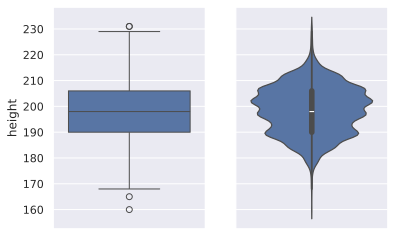

In [ ]:
_, axes = plt.subplots(1, 2, sharey=True, figsize=(6, 4))
sns.boxplot(data=players["height"], ax=axes[0])
sns.violinplot(data=players["height"], ax=axes[1]);

160 см це точно з аніме "Баскетбол курото" хлопець. Найнижчим у світі був Тайрон Мегсі Богс, давайте пошукаємо не в гуглі, а в дата сеті

In [ ]:
shortest_player = players.loc[players['height'].idxmin(), 'Player']
print(f'Саме він це і був - найнижчий гравець у світі: {shortest_player}')

Саме він це і був - найнижчий гравець у світі: Muggsy Bogues


In [ ]:
# Другий датасет
player_data.info();
player_data.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4550 entries, 0 to 4549
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   name        4550 non-null   object 
 1   year_start  4550 non-null   int64  
 2   year_end    4550 non-null   int64  
 3   position    4549 non-null   object 
 4   height      4549 non-null   object 
 5   weight      4544 non-null   float64
 6   birth_date  4519 non-null   object 
 7   college     4248 non-null   object 
dtypes: float64(1), int64(2), object(5)
memory usage: 284.5+ KB


,name,year_start,year_end,position,height,weight,birth_date,college
0,Alaa Abdelnaby,1991,1995,F-C,6-10,240.0,"June 24, 1968",Duke University
1,Zaid Abdul-Aziz,1969,1978,C-F,6-9,235.0,"April 7, 1946",Iowa State University
2,Kareem Abdul-Jabbar,1970,1989,C,7-2,225.0,"April 16, 1947","University of California, Los Angeles"
3,Mahmoud Abdul-Rauf,1991,2001,G,6-1,162.0,"March 9, 1969",Louisiana State University
4,Tariq Abdul-Wahad,1998,2003,F,6-6,223.0,"November 3, 1974",San Jose State University


In [ ]:
player_data.isna().sum()

# 0 на Nan
player_data["height"] = player_data["height"].fillna("0-0")
player_data["weight"] = player_data["weight"].fillna(0)
player_data["birth_date"] = player_data["birth_date"].fillna("Unknown")
player_data["college"] = player_data["college"].fillna("Unknown")


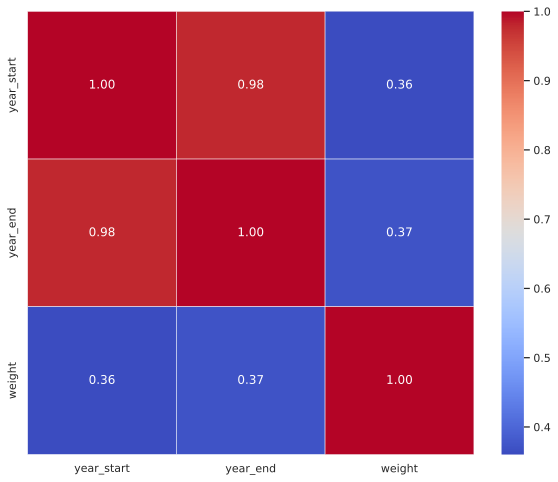

In [ ]:
# Оставляем только числовые переменные
numerical = player_data.select_dtypes(include=["number"]).columns

# Вычисляем корреляционную матрицу
corr_matrix = player_data[numerical].corr().fillna(0)

# Строим тепловую карту
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap="coolwarm", linewidths=0.5)
plt.show()


year_start та year_end очікувано корелюють, бо це тісно пов'язані дані. Можна спробувати одну, чи додати нову, наприклад, total_years, де буде значення year_end - year_start. Перейдемо на 3 датасет

In [ ]:
columns = [

  "TRB%",
  "3PAr",
  "AST%",
  "G",
  "PER",
  "FTr",
  "WS",
  "FG",
  "FT",
  "AST",
  "STL",
  "PF",
  "PTS",
]
sns.pairplot(seasons_stats[columns].sample(1000))

Як ми бачимо з цього pairplot, фіча PTS (очки) добре пов’язана з FG (влучні кидки) та FT (штрафні). Також є помітна залежність між AST% (процент передач) та AST (кількість передач). На ці взаємозв’язки варто звернути додаткову увагу.

In [ ]:
seasons_stats.fillna(0, inplace=True)

# Обчислюємо Impact Score
seasons_stats["Impact Score"] = (seasons_stats["PTS"] + seasons_stats["AST"] + seasons_stats["TRB"] + seasons_stats["STL"] + seasons_stats["BLK"]) - (seasons_stats["TOV"] + seasons_stats["PF"])

# Обчислюємо Scoring Efficiency (захист від ділення на нуль)(защита от деления на ноль)
seasons_stats["Scoring Efficiency"] = seasons_stats["PTS"] / (seasons_stats["FGA"] + seasons_stats["FTA"] * 0.44)
seasons_stats["Scoring Efficiency"] = seasons_stats["Scoring Efficiency"].fillna(0)

# Обчислюємо Aggressiveness Index
seasons_stats["Aggressiveness Index"] = (seasons_stats.get("FTr", 0) + seasons_stats.get("3PAr", 0) + seasons_stats.get("USG%", 0)) / 3

seasons_stats["Aggressiveness Index"] = seasons_stats["Aggressiveness Index"].fillna(0)

# Обчислюємо Defensive Activity
seasons_stats["Defensive Activity"] = (seasons_stats["STL"] + seasons_stats["BLK"]) / seasons_stats["G"]
seasons_stats["Defensive Activity"] = seasons_stats["Defensive Activity"].fillna(0)

# Обчислюємо Playmaking Impact
seasons_stats["Playmaking Impact"] = seasons_stats["AST%"] / seasons_stats["TOV%"]
seasons_stats["Playmaking Impact"] = seasons_stats["Playmaking Impact"].replace([float('inf'), -float('inf')], 0)
seasons_stats["Playmaking Impact"] = seasons_stats["Playmaking Impact"].fillna(0)


In [ ]:
plt.figure(figsize=(8, 6))
plt.scatter(seasons_stats["Scoring Efficiency"], seasons_stats["Impact Score"], alpha=0.5)
plt.xlabel("Scoring Efficiency")
plt.ylabel("Impact Score")
plt.title("Зависимость Impact Score от Scoring Efficiency")
plt.grid(True)
plt.show()

plt.figure(figsize=(8, 6))
plt.scatter(seasons_stats["Aggressiveness Index"], seasons_stats["Defensive Activity"], alpha=0.5, color='red')
plt.xlabel("Aggressiveness Index")
plt.ylabel("Defensive Activity")
plt.title("Зависимость Defensive Activity от Aggressiveness Index")
plt.grid(True)
plt.show()

In [ ]:
plt.figure(figsize=(8, 6))
plt.scatter(seasons_stats["Impact Score"], seasons_stats["Playmaking Impact"], alpha=0.5, color='green')
plt.xlabel("Impact Score")
plt.ylabel("Playmaking Impact")
plt.title("Зависимость Playmaking Impact от Impact Score")
plt.grid(True)
plt.show()

Додали ці метрики, щоб краще розуміти, як гравці впливають на гру. Impact Score показує, наскільки корисний гравець загалом, Scoring Efficiency – наскільки ефективно він набирає очки, Aggressiveness Index – як активно він діє в атаці, Defensive Activity – як добре грає в захисті, а Playmaking Impact – наскільки добре організовує гру.

Impact Score – загальна користь гравця на основі ключових показників
(PTS + AST + TRB + STL + BLK) - (TOV + PF)
→ Це спроба оцінити, наскільки гравець допомагає команді: додаємо очки, передачі, підбори, перехоплення і блоки, але віднімаємо втрати м’яча та фоли.

Scoring Efficiency – ефективність набору очок
PTS / (FGA + FTA * 0.44)
→ Чим менше спроб потрібно для очок, тим ефективніший гравець. Штрафні враховуємо як 0.44 від кидка, бо це стандартне коригування в NBA-аналітиці.

Aggressiveness Index – наскільки активно гравець впливає на гру
 (FTr + 3PAr + USG%) / 3
→ Включає частку штрафних, трьохочкових і використання м’яча. Високі значення можуть вказувати на атакувального лідера.

Defensive Activity – наскільки добре гравець захищається
(STL + BLK) / G
→ Чим більше перехоплень і блоків за гру, тим активніший гравець у захисті.

Playmaking Impact – наскільки добре гравець організовує гру
AST% / TOV%
→ Високе значення означає, що гравець більше створює моменти для команди, ніж втрачає м’яч.